# Importing the required packages

In [46]:

using DelimitedFiles
#using LightGraphs
using LinearAlgebra 
using PyPlot
using Random
#using BenchmarkTools
using Distributions
using StatsBase
using  OrdinaryDiffEq ###DifferentialEquations
using DiffEqCallbacks

# System size and intrinsic frequencies

In [47]:

N=10000;
#Random.seed!(123)
d=Cauchy()
omega=rand(d,N);
omega=omega-ones(N)*mean(omega)
v=rand(d,N);
v=v-ones(N)*mean(v);

# defining the function for simulation

In [48]:

function kuramoto(du, u, pp, t)

       u1 = @view u[1:N]
       du1 = @view du[1:N]
       u2 = @view u[N+1:2*N]
       du2 = @view du[N+1:2*N]
       
       j1,j2,k1,k2=pp

        z11 = Array{Complex{Float64},1}(undef, 1)
        z11= mean(exp.((u1+u2)*1im))
        z11c=conj(z11)
         
        z12 = Array{Complex{Float64},1}(undef, 1)
        z12= mean(exp.((u1-u2)*1im))
        z12c=conj(z12)
   
        z21 = Array{Complex{Float64},1}(undef, 1)
        z21= mean(exp.((u1+u2)*2im))

        z22 = Array{Complex{Float64},1}(undef, 1)
        z22= mean(exp.((u1-u2)*2im))
        

        ####### equ of motion\n",
        @. du1  = v + j1/2 * ( ( imag(z11*exp((-1im)*(u1+u2)) ))+( imag(z12*exp((-1im)*(u1-u2)) )) ) + j2/2*( ( imag(z21 * z11c * exp((-1im) * (u1+u2)) )) 
        + ( imag(z22 * z12c * exp((-1im) * (u1-u2)) )))
        @. du2 =  omega + k1/2 * ( ( imag(z11*exp((-1im)*(u1+u2)) ))-( imag(z12*exp((-1im)*(u1-u2)) )) ) + k2/2*( ( imag(z21 * z11c * exp((-1im) * (u1+u2)) )) 
        - ( imag(z22 * z12c * exp((-1im) * (u1-u2)) )))
       end;

# Integration times 

In [49]:

#dt = 0.01 # time step
dts = 1 # save time
ti = 0.0
tt = 1000
tf = 1500
nt = Int(div(tt,dts))
nf = Int(div(tf,dts))

tspan = (ti, tf); # time interval

# Initial Conditions

In [50]:

#u0=[-pi*ones(N)+rand(N)*2*pi;-pi*ones(N)+rand(N)*2*pi]; ## for forward 
#u0=[pi*1.99*ones(N)+rand(N)*0.01*pi;pi*1.99*ones(N)+rand(N)*0.01*pi]; ## for backward
u0=[(-pi*ones(N)+rand(N)*2*pi)*0.01;(-pi*ones(N)+rand(N)*2*pi)*0.01] ;

# Parameter values

In [51]:

k1 =3.1 
j1= 3.1
k2= 9
j2= 9

9

# Integration

In [ ]:

    
    @time begin
    # defining problem for ODE solver
    prob = ODEProblem(kuramoto, u0, tspan, (j1,j2,k1,k2))
    
        saved_values1= SavedValues(Float64, Float64)
       function saver1(u,t,integrator)
          _re1=mean(cos.(u[1:N]+u[N+1:2*N]))
          _im1=mean(sin.(u[1:N]+u[N+1:2*N]))
          out1=sqrt(_re1^2 + _im1^2)
       end
     cb1 = SavingCallback(saver1, saved_values1,saveat=ti:dts:tf)

      saved_values2= SavedValues(Float64, Float64)
       function saver2(u,t,integrator)
          _re2=mean(cos.(u[1:N]-u[N+1:2*N]))
          _im2=mean(sin.(u[1:N]-u[N+1:2*N]))
          out2=sqrt(_re2^2 + _im2^2)
       end
     cb2 = SavingCallback(saver2, saved_values2,saveat=ti:dts:tf)
     
      cbs = CallbackSet(cb1, cb2)

     sol = solve(prob, Tsit5(),progress=true,callback = cbs,saveat=ti:dts:tf);

    
     sp_fwd_t= saved_values1.saveval;
     sm_fwd_t= saved_values2.saveval;

        
end;     


# Visualizing the last time instance

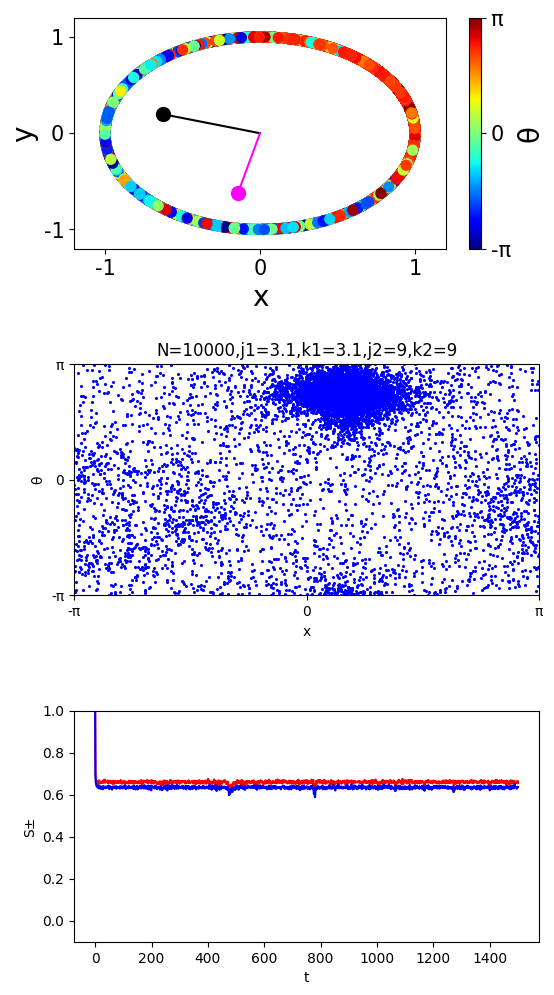

In [43]:
    x = -pi*ones(N)+mod2pi.(sol[1:N,end])
    θ = -pi*ones(N)+mod2pi.(sol[N+1:2*N,end])
    
    wpe= mean(exp.((x+θ)*1im))
    wme= mean(exp.((x-θ)*1im)) 
    rpe=abs.(wpe) 
    ψpe=angle.(wpe)
    rme=abs.(wme)
    ψme=angle.(wme);



clf()
figure(figsize=(6, 12))
##################################    
    subplot(311)
    xlim(-1.2,1.2)
    ylim(-1.2,1.2) 
    xlabel("x", fontsize=20)
    ylabel("y", fontsize=20)
    ticks = [-1, 0, 1]
    tick_labels = ["-1", "0", "1"]
    PyPlot.xticks(ticks, tick_labels, fontsize=15)
    PyPlot.yticks(ticks, tick_labels, fontsize=15)
    scatter(cos.(x),sin.(x),c=θ,cmap="jet",vmin=-π, vmax=π,s=50)
    colorbar_obj = colorbar(label="θ", ticks=[-π, 0, π])
    colorbar_obj.ax.set_yticklabels(["-π", "0", "π"], fontsize=15)
    colorbar_obj.set_label("θ", fontsize=20)
    pte1x=[0,rpe*cos(ψpe)]
    pte1y=[0,rpe*sin(ψpe)]
    pte2x=[0,rme*cos(ψme)]
    pte2y=[0,rme*sin(ψme)]
    scatter(pte1x[2],pte1y[2],c="black",s=100)
    scatter(pte2x[2],pte2y[2],c="magenta",s=100)
    plot(pte1x,pte1y, c="black" )
    plot(pte2x,pte2y, c="magenta" )
####################################################

subplot(312)
p2=scatter(x,θ,c="blue",s=1.5)
xlabel("x")
ylabel("θ")
ylim(-π,π)
xlim(-π,π)
title("N=$N,j1=$j1,k1=$k1,j2=$j2,k2=$k2")
ticks = [-π, 0, π]
tick_labels = ["-π", "0", "π"]
PyPlot.xticks(ticks, tick_labels)
PyPlot.yticks(ticks, tick_labels)
####################################################
subplot(313)
p3=plot(sp_fwd_t,c="red")
plot(sm_fwd_t,c="blue")
ylim(-0.1,1)
xlabel("t")
ylabel("S±")
subplots_adjust(hspace=0.5)
#gcf()


# Unpacking the solution

In [130]:

l=length(sol)
x1=Array{Vector{Float64}}(undef,l)
θ1=Array{Vector{Float64}}(undef,l)
wp=Array{Complex{Float64}}(undef,l)
wm=Array{Complex{Float64}}(undef,l)
for j in 1:l
x1[j] = -pi*ones(N)+mod2pi.(sol[1:N,j])
θ1[j] = -pi*ones(N)+mod2pi.(sol[N+1:2*N,j])
wp[j]= mean(exp.((x1[j]+θ1[j])*1im))
wm[j]= mean(exp.((x1[j]-θ1[j])*1im))        
end

rp1=abs.(wp)
ψp1=angle.(wp)
rm1=abs.(wm)
ψm1=angle.(wm);


# Making animation and save as mp4 video

In [131]:
using PyCall
@pyimport matplotlib.animation as anim
using PyPlot

using Base64

function showmp4(filename)
    open(filename) do f
        base64_video = base64encode(f)
        display("text/html", """<video controls src="data:video/mp4;base64,$base64_video"></video>""")
    end
end


fig = figure(figsize=(21, 6))
ax = PyPlot.gca()


function plotw(t)
       
    clf()
        
    subplot(131)
    title("\$t = $t\$",fontsize=20)
    xlim(-1.2,1.2)
    ylim(-1.2,1.2) 
    xlabel("x", fontsize=20)
    ylabel("y", fontsize=20)
    ticks = [-1, 0, 1]
    tick_labels = ["-1", "0", "1"]
    PyPlot.xticks(ticks, tick_labels, fontsize=15)
    PyPlot.yticks(ticks, tick_labels, fontsize=15)
    scatter(cos.(x1[Int(t)+1]),sin.(x1[Int(t)+1]),c=θ1[Int(t)+1],cmap="jet",vmin=-π, vmax=π,s=50)
    colorbar_obj = colorbar(label="θ", ticks=[-π, 0, π])
    colorbar_obj.ax.set_yticklabels(["-π", "0", "π"], fontsize=15)
    colorbar_obj.set_label("θ", fontsize=20)
    pt1x=[0,rp1[t+1]*cos(ψp1[t+1])]
    pt1y=[0,rp1[t+1]*sin(ψp1[t+1])]
    pt2x=[0,rm1[t+1]*cos(ψm1[t+1])]
    pt2y=[0,rm1[t+1]*sin(ψm1[t+1])]
    scatter(pt1x[2],pt1y[2],c="black",s=100)
    scatter(pt2x[2],pt2y[2],c="magenta",s=100)
    plot(pt1x,pt1y, c="black" )
    plot(pt2x,pt2y, c="magenta" )
    gca()[:set_aspect]("equal")
    
    subplot(132)
    title("\$t = $t\$",fontsize=20)
    xlim(-π,π)
    ylim(-π,π) 
    xlabel("x", fontsize=20)
    ylabel("θ", fontsize=20)
    ticks = [-π, 0, π]
    tick_labels = ["-π", "0", "π"]
    PyPlot.xticks(ticks, tick_labels, fontsize=15)
    PyPlot.yticks(ticks, tick_labels, fontsize=15)
    scatter(x1[Int(t)+1],θ1[Int(t)+1],c="blue",s=2.0)
    gca()[:set_aspect]("equal")
    
    
    subplot(133)
    title("\$t = $t\$",fontsize=20)
    xlim(-π,π)
    ylim(-π,π)
    xlabel("ξ", fontsize=20)
    ylabel("η", fontsize=20)
    ticks = [-π, 0, π]
    tick_labels = ["-π", "0", "π"]
    PyPlot.xticks(ticks, tick_labels, fontsize=15)
    PyPlot.yticks(ticks, tick_labels, fontsize=15)
    scatter(x1[Int(t)+1]+θ1[Int(t)+1],x1[Int(t)+1]-θ1[Int(t)+1],c="blue",s=2.0)
    gca()[:set_aspect]("equal")
    
    subplots_adjust(wspace=0.5) ## for horizontal spacing 
    #subplots_adjust(hspace=0.8) ## for vertical spacing
    plot()
end


n=l # frame
interval=200 # time between two frames in milli seconds

# k=0,1,...,frames-1
function animate(k)
    plotw(k)
end

function init()
    plotw(0)
end



# Increase the bitrate and DPI for high resolution
bitrate = -1
dpi = 100

withfig(fig) do
    global myanim = anim.FuncAnimation(fig, animate, frames=n, init_func=init, interval=interval, blit=true)
    myanim[:save]("test5.mp4", dpi=dpi, bitrate=bitrate, extra_args=["-vcodec", "libx264"])
end

showmp4("test5.mp4")



#withfig(fig) do
#    global myanim = anim.FuncAnimation(fig, animate, frames=l*n+1, init_func=init, interval=interval, blit=true)
#    myanim[:save]("test4.mp4", bitrate=-1, extra_args=["-vcodec", "libx264", "-pix_fmt", "yuv480p"])
#end

#showmp4("test4.mp4")



<video controls src="data:video/mp4;base64,AAAAIGZ0eXBpc29tAAACAGlzb21pc28yYXZjMW1wNDEAAAAIZnJlZQEnhtBtZGF0AAACrgYF//+q3EXpvebZSLeWLNgg2SPu73gyNjQgLSBjb3JlIDE2MyByMzA2MCA1ZGI2YWE2IC0gSC4yNjQvTVBFRy00IEFWQyBjb2RlYyAtIENvcHlsZWZ0IDIwMDMtMjAyMSAtIGh0dHA6Ly93d3cudmlkZW9sYW4ub3JnL3gyNjQuaHRtbCAtIG9wdGlvbnM6IGNhYmFjPTEgcmVmPTMgZGVibG9jaz0xOjA6MCBhbmFseXNlPTB4MzoweDExMyBtZT1oZXggc3VibWU9NyBwc3k9MSBwc3lfcmQ9MS4wMDowLjAwIG1peGVkX3JlZj0xIG1lX3JhbmdlPTE2IGNocm9tYV9tZT0xIHRyZWxsaXM9MSA4eDhkY3Q9MSBjcW09MCBkZWFkem9uZT0yMSwxMSBmYXN0X3Bza2lwPTEgY2hyb21hX3FwX29mZnNldD0tMiB0aHJlYWRzPTEyIGxvb2thaGVhZF90aHJlYWRzPTIgc2xpY2VkX3RocmVhZHM9MCBucj0wIGRlY2ltYXRlPTEgaW50ZXJsYWNlZD0wIGJsdXJheV9jb21wYXQ9MCBjb25zdHJhaW5lZF9pbnRyYT0wIGJmcmFtZXM9MyBiX3B5cmFtaWQ9MiBiX2FkYXB0PTEgYl9iaWFzPTAgZGlyZWN0PTEgd2VpZ2h0Yj0xIG9wZW5fZ29wPTAgd2VpZ2h0cD0yIGtleWludD0yNTAga2V5aW50X21pbj01IHNjZW5lY3V0PTQwIGludHJhX3JlZnJlc2g9MCByY19sb29rYWhlYWQ9NDAgcmM9Y3JmIG1idHJlZT0xIGNyZj0yMy4wIHFjb21wPTAuNjAgcXBtaW49MCBxcG1heD02OSBxcHN0ZXA9NCBpcF9yYXRpbz0xLjQwIGFxPTE6MS4wMACAAAAmAGWIhAAU//73x0/Apuj5ZsudRT0hMIrY+kgovVjs0DJ1AAADAAADAAADAAADAAADAGPTWrHMgxrZp4SAAAADAAADAAfgAAADADLgAADhwDRENh/4UwnuBA/3g13IUr4CtF1sN2mp+UOHmpLw+cpgbOiWN3vsQjjadSXJ6tbZ7PHZOjWeqAgoqJV0ayU2644Ia2Y4FRjwfeGKT49xkojVQNJpJiozWRaCZSL3y593KyU4nN6BMR3rQPmbIvufTnEzCJ7P5iT6xd6kVTdhjE9QgVTM5GQGmyifgs3czax4WQ8RQ2giEiIyx4/ggU3ZH5znGxXjPuh24tRVGkL0EKVa6ROaiRmcCP2rMMGFa5S+gZyigAIpelF0IyRtp8cWvYPKkT/EaLvbkmFfYXoVdLyElMy2hxHJ+w2ThlwZqB1GXd/tNcBUVj25MlaVwENAKu0ic3KBApDPjhx0sHQUlh3Po/NmK1zqDw1nN8REnRDUpn6TQn4otyX+WZ4tXSTZbl0IF8apWaPJRnutQzfPnnPisQ0/erHPf6pUPSnJOf4HmrO7FoFbV1vxZUJLPjwbekjISaHv9mTkDe2WkjeVkOP8YG5A9fwmhTvwellxZILVeEOeGolVwB2S42+I8BsjjoIzsBa+7rQ33LCuOsRNIVb3Cd5mO7PhIUlcVVFmMe/XQ0XJTiQbRlQ/zIhNYkjM5yHG1QkLbS5OzA4fhoivpd48Shbw77omaw//K0hmfiQwef9QhjFi0un9lbCaF3C6d+jOdCm6Ve0PLC6DaDh5VpGT/eRFJOi6Uz+b/mteU1PK6S3aoWbemELapgHYO24zIDlV63fIZLZ08C70+WFKZRLJPdukSm4swPECzrZ67ED+8tGuh7UBRBalspRla5YiD0xEYza4cR7EmsEvlXq2clSLS9mqXjyzED/QFtl7+5jgEg5M8J4/LIirZLZJVO57/070cjRuiilxhFcJERHxjN/daVTIi07pJR8Uml3z9EZBqD2zKxff58QPQ/j/L7eszxv7XhEtODkG12OfuYkETBXUblAt/i7dxaZx7zE4vFugbOzoKCtZ1AXyFD3NVKYH9UMxekZgJiO1MWCrNMgkbCD13TZYc/YIJiZKzj3LDRbt78tFli3JPnxuBmYv3ciRgjisQBH5VxhQmmoX9WK7B8hn5RqxxVLvJu2vkFePHK6//UAefSVKikQNDsCvEa5kb6x5E3Z+KtO9g+6ptK4Pdfg3geR6Yt18CwGYpUf1OMNxGpfUSfkK+36s6TDIm7B/Cliub3g3Aq6C9/mo4CtJlWlRFYc2kLHNV27jR+wuKU5RQo3C27DeVkw3d0OWhjd/1Nv9ZcBi0wJ6N6GOUbTIQi4d6Csb0oB7px1ox6pO3aYCM8bQjP9sEmSwlzaUHaRNKuc8K7YZ/P+B9B+7gsnTcJ6ZphBXdArehjhpE6aqa1JATLGZ+yQGfyP6tB7rgTE33+agsL8wF9sT44fi/ETyVQeKT7iMzPofLDuLIsvIk7Afr1LHzlGUgwIhN4rY0Z8yZy7bgyz9NcSNZSs+0ABZEFFEZ5J8LvzX2EUTde5Nyw0T0z+bniKDPsAq+TPacLmBk3oqqoRjqlO0P/eKTqNgSbYPa1rc3inliiEMfH1+oyv2tggBA9Bq3nv4PJCZhsreWq4Q597dSse37Rb7G6xxSVjmknhvwGXMG35VDA/Au87MukkBxpm+M2pqFpt/nCm0slZ9Dh8qqN5w63IqwJaN3XbB07yg1h7VxcfFHJEiGCh4fu8Oynbbgge58wJxDL9RbVKXulh2Ejc/YpWKJVVNAh1qtS3fL6ERw1xCU1vc0Wg9cuceNsYE6nqa4aXm75/O/7vrEeXUSJsXk41RKi7swqpt/VxyvOO4NQQU/WZhzIwrDWNwP5e2DOXXTqFUVgcbLgKXl0mNCag8DrOMnto8+MFhSs1VEop2yTixCIXA/SxKbzDlUEzB/XFRley7pxiWGXMtNwt0n9eQAVi7nmjka561YKktv4z4nnme7RTAeeAatwPjM3lGLda3GCGyFS+IVQg3aFq1pIE1bW9viyOhRRltv90aM++JWH50hSV1MADbrrjwjl88PAoyBRHhY7aiEU72LBGff/RHxQyB7A4itxOKS9BrtDZJpLAU3/rz6ouYLExeryWHX5TsI+FYHdsEUtd+olVWmvKiP1TFPRT6x5InApXYRqIRdpXBkViEouyIlatVMHL3EnGc6GKoxDVJp+ffoP/6A4UkYdSht8tDwNePs70WDnusMWSDaeoAvaD6qnVlaGp7Z/JYfACWmjPurBvWUWtf4OKWF0pcrxJqW5ejzd9/2tF0bHdh8b1pbr3DPiliUCQCrFp90CETtbhdiJiMfu+8v47bmYLb7/aiWZu8DkgTImfN5+OOuwjxKKBJn43XCOCdLPqYOL3vqMJeSM/eb5r0KoyS2GnVBjqYC4eYpnkTasuh8J6ylN1N8yrTqsKl8IP0jR0SvghSolCZVEixgj4GWeXePmNySv1N1DGhD4Jx3hFaJ9ToevHwyxa6XZasWplbo3XKn/86ZZMxgUnr3nu9UgujbBMF6/nDeDkC76hxNnhw5vrXW4KQAkygZbDS7sxgVAbc9MTLiIOD90NKpR86pq67SH6SScH/1w82Lf3SSeqXQKyMcyNf/nBLlo5/fM66THMwa9YDI/SdxBazbaYD9/IGxwO8NFrDFJC3RP2nnProZzB2kNO1JUnOdLn1Kc1sQx9ATNqfQd52ji3viRn6/Nm8u17zpco7gDG8K7sj5L30YifatmXQI4afQ132JK1zwsDctE0vihIy5LbC/XZ+0aPaVfu19hmtM0EZn0KKEKgJ0FCn2EtO6y2iRQrXs1nXz03+Er4vZfkUzv1HqFuuRVRcHPQU5XEsmNluN15PEdbYoUOMZIXTcO43YkZNmluCs4EPJj6PrrfzcbFRieoajRM2W4YtKmww/8Bobb/PO

# Some extra tests 

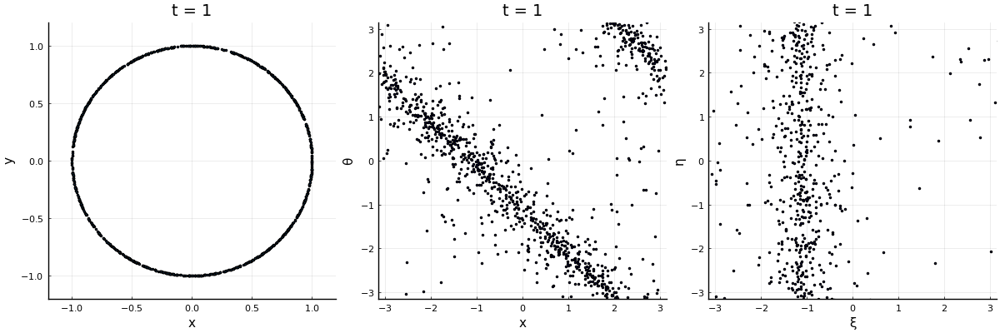

In [27]:
t=1
plot1 = plot(xlim=(-1.2, 1.2), ylim=(-1.2, 1.2), xlabel="x", ylabel="y")
    title!(plot1, "t = $t")
    scatter!(cos.(x1[Int(t) + 1]), sin.(x1[Int(t) + 1]), ms=1.5, colorbar=true)
    #aspect_ratio_equal!(plot1)

    plot2 = plot(xlim=(-π, π), ylim=(-π, π), xlabel="x", ylabel="θ")
    title!(plot2, "t = $t")
    scatter!(x1[Int(t) + 1], θ1[Int(t) + 1], mc="blue", ms=1.5)
    #aspect_ratio_equal!(plot2)

    plot3 = plot(xlim=(-π, π), ylim=(-π, π), xlabel="ξ", ylabel="η")
    title!(plot3, "t = $t")
    scatter!(x1[Int(t) + 1] + θ1[Int(t) + 1], x1[Int(t) + 1] - θ1[Int(t) + 1], mc="blue", ms=1.5)
    #aspect_ratio_equal!(plot3)

    plot(plot1, plot2, plot3, layout=(1, 3), size=(1200, 400), legend=false)

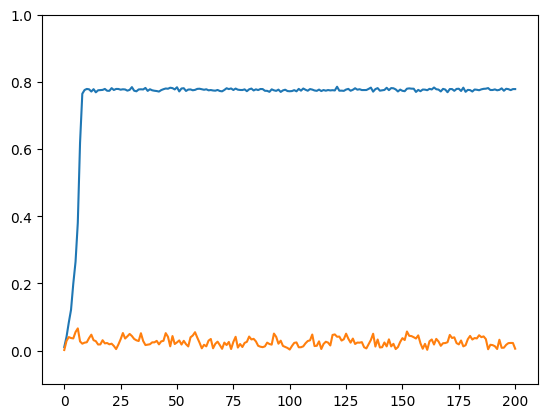

(-0.1, 1.0)

In [22]:
plot(abs.(wm))
plot(abs.(wp))    
ylim(-0.1,1)

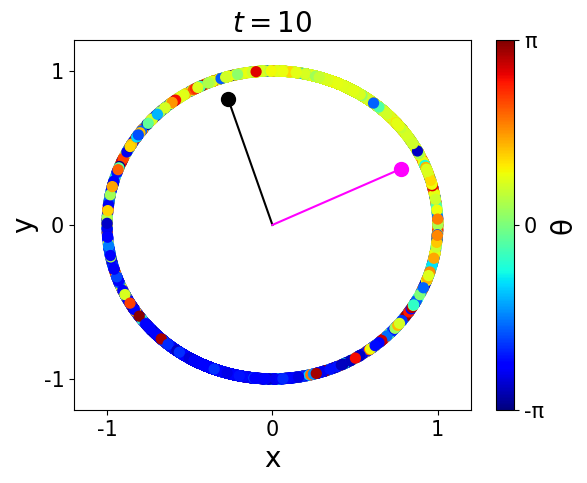

1-element Vector{PyObject}:
 PyObject <matplotlib.lines.Line2D object at 0x7f9238786820>

In [50]:
t=10
clf()
        
    title("\$t = $t\$",fontsize=20)
    xlim(-1.2,1.2)
    ylim(-1.2,1.2) 
    xlabel("x", fontsize=20)
    ylabel("y", fontsize=20)
    ticks = [-1, 0, 1]
    tick_labels = ["-1", "0", "1"]
    PyPlot.xticks(ticks, tick_labels, fontsize=15)
    PyPlot.yticks(ticks, tick_labels, fontsize=15)
    scatter(cos.(x1[Int(t)+1]),sin.(x1[Int(t)+1]),c=θ1[Int(t)+1],cmap="jet",vmin=-π, vmax=π,s=50)
    colorbar_obj = colorbar(label="θ", ticks=[-π, 0, π])
    colorbar_obj.ax.set_yticklabels(["-π", "0", "π"], fontsize=15)
    colorbar_obj.set_label("θ", fontsize=20)
    
    pt1x=[0,rp1[t+1]*cos(ψp1[t+1])]
    pt1y=[0,rp1[t+1]*sin(ψp1[t+1])]
    pt2x=[0,rm1[t+1]*cos(ψm1[t+1])]
    pt2y=[0,rm1[t+1]*sin(ψm1[t+1])]
    scatter(pt1x[2],pt1y[2],c="black",s=100)
    scatter(pt2x[2],pt2y[2],c="magenta",s=100)
    plot(pt1x,pt1y, c="black" )
    plot(pt2x,pt2y, c="magenta" )
    #gca()[:set_aspect]("equal")

In [13]:
1/2.83

0.35335689045936397